In [27]:
import json
import jsonlines
import os
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import numpy as np
from sklearn.metrics import roc_auc_score, log_loss, f1_score, confusion_matrix, classification_report
import random

In [14]:
pred_oi = pd.read_csv('test_result/nsb2_oi_tst2.csv')
pred_oi

,image_id,dir,label,pred,confidence score
0,a958ed2b0fa87134.jpg,../../disk/Data/open_image/train_a,0,0,1.000000
1,188b3a3196296493.jpg,../../disk/Data/open_image/train_1,0,0,1.000000
2,0af8f862c03859bb.jpg,../../disk/Data/open_image/train_0,0,0,1.000000
3,40b23fa94d4b6d66.jpg,../../disk/Data/open_image/train_4,0,0,1.000000
4,0f1e8a716d4bc553.jpg,../../disk/Data/open_image/train_0,0,0,1.000000
...,...,...,...,...,...
1743037,112caf3e075e5394.jpg,../Data/disaster_images/open_image_disaster,1,0,0.998633
1743038,0bdfcf59dd6b55ce.jpg,../Data/disaster_images/open_image_disaster,1,0,0.999864
1743039,0128105921974df0.jpg,../Data/disaster_images/open_image_disaster,1,0,0.991148
1743040,2341349abfc26e90.jpg,../Data/disaster_images/open_image_disaster,1,0,0.715412


In [15]:
test_acc = np.sum(pred_oi.label == pred_oi.pred) / len(pred_oi)
test_matrix = confusion_matrix(pred_oi['label'], pred_oi['pred'])
epoch_f1 = f1_score(pred_oi['label'], pred_oi['pred'], average='macro')

print(f'accuracy: {test_acc:.4f}')
print(f'f1_score: {epoch_f1:.4f}')
print(f'confusion_matrix \n-------------------------\n {test_matrix}')

accuracy: 0.9988
f1_score: 0.5101
confusion_matrix 
-------------------------
 [[1740957    1921]
 [    142      22]]


In [ ]:
## caption 수집을 위한 annotation
image_id = []
captions = []
dir_path = "../Data/annotations/"
ano = "open_images_train_v6_captions.jsonl"

with jsonlines.open(dir_path+ano, 'r') as f:
    for line in f.iter():
        #if line['image_id'][0] == '0':
        image_id.append(line['image_id']+'.jpg')
        captions.append(line['caption'])
annotations = pd.DataFrame(image_id, columns=['image_id'])
annotations['caption'] = captions
annotations

In [ ]:
non_matched_idx = (pred_oi['label'] != 1) & (pred_oi['label'] != pred_oi['pred'])
non_matched = pred_oi[non_matched_idx].reset_index(inplace = False, drop=True)

non_matched.sort_values(by=['image_id'],ascending=True, inplace=True)
tmp = non_matched['image_id'].value_counts().index.sort_values()
non_matched

In [37]:
non_matched_merged = pd.merge(non_matched, annotations, how='left', left_on='image_id', right_on='image_id')
non_matched_merged

,image_id,dir,label,pred,confidence score,caption
0,0006427f95b3ba15.jpg,../../disk/Data/open_image/train_0,0,1,0.987298,NaN
1,001af0f70d8baa79.jpg,../../disk/Data/open_image/train_0,0,1,0.649526,NaN
2,002fffcd494be88c.jpg,../../disk/Data/open_image/train_0,0,1,0.996025,NaN
3,0035c9cb0422e1b4.jpg,../../disk/Data/open_image/train_0,0,1,0.999852,NaN
4,003f5f4ed61c7528.jpg,../../disk/Data/open_image/train_0,0,1,0.984837,NaN
...,...,...,...,...,...,...
1920,ffa2dc2994faa3b8.jpg,../../disk/Data/open_image/train_f,0,1,0.673317,NaN
1921,ffb9d0b9dbc5de6a.jpg,../../disk/Data/open_image/train_f,0,1,0.916986,NaN
1922,ffbe12d1eb28162d.jpg,../../disk/Data/open_image/train_f,0,1,0.993491,"In this image I can see suitcases, cartons and..."
1923,ffc4910c2c84a156.jpg,../../disk/Data/open_image/train_f,0,1,0.997066,In this image we can see buildings and windows...


In [43]:
cnt = 4
for i,key in enumerate(tmp):
    if cnt == 4:
        print('', end='\n\n\n\n')
        print(f'{(i+1)/4}.')
        cnt = 0
    print(f"'{key}'", end=' ')
    cnt+=1






0.25.
'0006427f95b3ba15.jpg' '001af0f70d8baa79.jpg' '002fffcd494be88c.jpg' '0035c9cb0422e1b4.jpg' 



1.25.
'003f5f4ed61c7528.jpg' '004676114a592ae3.jpg' '004db3b05bc35e1c.jpg' '004eb09868950461.jpg' 



2.25.
'00516b74e8895db3.jpg' '005907e53e920130.jpg' '006f1612fece7677.jpg' '00825c42adba45c7.jpg' 



3.25.
'00ab2302dd3a7290.jpg' '00ab50d54b69434e.jpg' '00c67f2d5be04bb3.jpg' '00d4416678308217.jpg' 



4.25.
'00db092ac5a3c7bc.jpg' '00df647b3a29f5ea.jpg' '00e1a9a99e89b80b.jpg' '00faae9928a54f0d.jpg' 



5.25.
'0109ba24d0890152.jpg' '010e0a06861fb0b6.jpg' '013223f142cc1c07.jpg' '0137ee7ab7533723.jpg' 



6.25.
'014580f9c02d732f.jpg' '014bd5e60ae7ce28.jpg' '0152217279ad41f4.jpg' '01554b6a8722840d.jpg' 



7.25.
'01994b2eb7fc7ceb.jpg' '01b7e552aed7ad9a.jpg' '01c39f04aea69ccc.jpg' '01d0e6d2f7117a36.jpg' 



8.25.
'022aa78f4e462a19.jpg' '023e012783a4d7aa.jpg' '023ecb3eb371a031.jpg' '0254a8ce2a7939b4.jpg' 



9.25.
'025a73adb710c87d.jpg' '0267e5ff057b41bd.jpg' '029a2ef4ccdc3946.jpg' '02

In [41]:
non_matched_merged['caption'].isnull()[0]

True

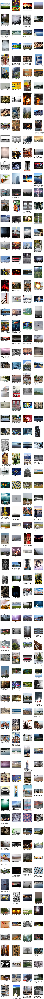

In [42]:
## show img status

back = 0
plt.figure(figsize=(16,500))
for i in range(len(non_matched_merged[back:300])):
    plt.subplot(100,4,i+1)
    if i % 4 == 0:
        plt.title(f"{(i+1+back)/4}")
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    
    path = non_matched_merged['dir'][i] + '/' + non_matched_merged['image_id'][i]
    im_bgr = cv2.imread(path)
    im_rgb = im_bgr[:, :, ::-1]
    plt.imshow(im_rgb, cmap=plt.cm.binary)
    
    if non_matched_merged['caption'].isnull()[i+back]:
        plt.xlabel('image_id : '+ str(non_matched_merged['image_id'][i+back]) , loc='left', fontsize=10)
    else : 
        plt.xlabel(non_matched_merged['caption'][i+back][:35] + '\n' + non_matched_merged['caption'][i+back][35:70] + '\n' 
               + non_matched_merged['caption'][i+back][70:105] + '\n image_id : ' + str(non_matched_merged['image_id'][i+back]) , loc='left', fontsize=10)
    #plt.legend(find['image_id'][i])
plt.show()